<a href="https://colab.research.google.com/github/taras-musakovskyi/colab-jupyter-fish-models/blob/main/Inference_SD_LoRA15.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!/usr/bin/env python3
"""
Stable Diffusion 1.5 LoRA Inference Notebook (Point 1a)
Load trained fish generation LoRA from Google Drive and generate images
"""

# ============================================================================
# CELL 1: Setup and Installation
# ============================================================================
!pip install -q diffusers transformers accelerate safetensors
!pip install -q torch torchvision --upgrade
!pip install -q peft huggingface_hub

import torch
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler
from peft import PeftModel
from PIL import Image
import os
from datetime import datetime
from IPython.display import display

print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)}")



PyTorch version: 2.8.0+cu126
CUDA available: True
GPU: Tesla T4


In [ ]:
# ============================================================================
# CELL 2: Google Drive Authentication and Download Model
# ============================================================================
from google.colab import auth, drive
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload
import io

print("🔐 Authenticating with Google Drive...")
auth.authenticate_user()
from google.auth import default
creds, _ = default()

drive_service = build('drive', 'v3', credentials=creds)
print("✓ Authentication successful!")

# Your Google Drive file ID for the trained LoRA model
# Get this from the file's shareable link or from the upload output
LORA_MODEL_FILE_ID = "1raH1cOdNGIJZ5xMX925NbTHPuBuDXG7H"
# Download model from Google Drive
def download_file_from_gdrive(file_id, destination_path):
    """Download file from Google Drive"""
    print(f"\n📥 Downloading model from Google Drive...")

    request = drive_service.files().get_media(fileId=file_id)

    # Create directory if needed
    os.makedirs(os.path.dirname(destination_path), exist_ok=True)

    fh = io.FileIO(destination_path, 'wb')
    downloader = MediaIoBaseDownload(fh, request)

    done = False
    while done is False:
        status, done = downloader.next_chunk()
        if status:
            print(f"   Download progress: {int(status.progress() * 100)}%")

    fh.close()
    print(f"✓ Model downloaded to: {destination_path}")
    print(f"   Size: {os.path.getsize(destination_path) / (1024**2):.2f} MB")

# Download the LoRA model
LOCAL_LORA_PATH = "/content/lora_models"
os.makedirs(LOCAL_LORA_PATH, exist_ok=True)

if "YOUR_FILE_ID_HERE" in LORA_MODEL_FILE_ID:
    print("\n⚠️ WARNING: Set LORA_MODEL_FILE_ID to your actual Google Drive file ID!")
    print("\nTo get the file ID:")
    print("1. Find your uploaded model in Google Drive")
    print("2. Right-click → Share → Copy link")
    print("3. Extract ID from URL: https://drive.google.com/file/d/FILE_ID_HERE/view")
    print("4. Paste the ID in LORA_MODEL_FILE_ID above")
else:
    download_file_from_gdrive(
        LORA_MODEL_FILE_ID,
        f"{LOCAL_LORA_PATH}/lora_best_from_gdrive.safetensors"
    )



🔐 Authenticating with Google Drive...
✓ Authentication successful!

📥 Downloading model from Google Drive...
   Download progress: 100%
✓ Model downloaded to: /content/lora_models/lora_best_from_gdrive.safetensors
   Size: 24.37 MB


In [ ]:
# ============================================================================
# CELL 3: Alternative - Mount Google Drive (if you prefer)
# ============================================================================
# Uncomment this section if you prefer to mount Drive instead of downloading

# from google.colab import drive
# drive.mount('/content/drive')

# # Point to your model in Drive
# LORA_MODEL_PATH = "/content/drive/MyDrive/sd_lora_models/lora_best_epoch_24_TIMESTAMP.safetensors"
#
# if os.path.exists(LORA_MODEL_PATH):
#     print(f"✓ Found model at: {LORA_MODEL_PATH}")
# else:
#     print(f"❌ Model not found at: {LORA_MODEL_PATH}")
#     print("\nUpdate LORA_MODEL_PATH with the correct path from your Google Drive")



In [ ]:
# ============================================================================
# CELL 4: Load Base Model and LoRA
# ============================================================================
print("\n" + "="*60)
print("LOADING MODELS")
print("="*60)

MODEL_NAME = "runwayml/stable-diffusion-v1-5"
LORA_PATH = f"{LOCAL_LORA_PATH}/lora_best_from_gdrive.safetensors"  # Adjust if using mounted Drive

# Check if LoRA exists
if not os.path.exists(LORA_PATH):
    print(f"❌ LoRA model not found at: {LORA_PATH}")
    print("\nMake sure you either:")
    print("1. Downloaded the model in CELL 2, OR")
    print("2. Mounted Drive and set correct path in CELL 3")
    raise FileNotFoundError(f"LoRA model not found: {LORA_PATH}")

print(f"\n✓ LoRA model found: {LORA_PATH}")

# Determine device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

# Load base Stable Diffusion pipeline
print("\nLoading Stable Diffusion 1.5...")
pipeline = StableDiffusionPipeline.from_pretrained(
    MODEL_NAME,
    torch_dtype=torch.float16 if device == "cuda" else torch.float32,
    safety_checker=None,  # Disable for speed
)

# Use faster scheduler
#pipeline.scheduler = DPMSolverMultistepScheduler.from_config(
#    pipeline.scheduler.config
#)
from diffusers import EulerAncestralDiscreteScheduler
pipeline.scheduler = EulerAncestralDiscreteScheduler.from_config(
    pipeline.scheduler.config
)

print("✓ Base model loaded")

# Load LoRA weights
print(f"\nLoading LoRA weights from: {os.path.basename(LORA_PATH)}")

# Check if it's a directory (PEFT format) or single file
if os.path.isdir(LORA_PATH):
    # PEFT directory format
    pipeline.unet = PeftModel.from_pretrained(
        pipeline.unet,
        LORA_PATH,
        adapter_name="fish_lora"
    )
else:
    # Single file format - need to extract and load
    # Create temporary directory for PEFT format
    import shutil
    temp_lora_dir = "/content/temp_lora"
    os.makedirs(temp_lora_dir, exist_ok=True)
    shutil.copy(LORA_PATH, f"{temp_lora_dir}/adapter_model.safetensors")

    # Create adapter_config.json
    import json
    adapter_config = {
        "base_model_name_or_path": MODEL_NAME,
        "peft_type": "LORA",
        "r": 32,
        "lora_alpha": 64,
        "target_modules": ["to_k", "to_q", "to_v", "to_out.0"],
        "lora_dropout": 0.1,
    }
    with open(f"{temp_lora_dir}/adapter_config.json", "w") as f:
        json.dump(adapter_config, f, indent=2)

    pipeline.unet = PeftModel.from_pretrained(
        pipeline.unet,
        temp_lora_dir,
        adapter_name="fish_lora"
    )

print("✓ LoRA loaded successfully")

# Move to device
pipeline = pipeline.to(device)
print(f"✓ Pipeline moved to {device}")

print("\n" + "="*60)
print("READY FOR GENERATION")
print("="*60)




LOADING MODELS

✓ LoRA model found: /content/lora_models/lora_best_from_gdrive.safetensors
Using device: cuda

Loading Stable Diffusion 1.5...


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


✓ Base model loaded

Loading LoRA weights from: lora_best_from_gdrive.safetensors
✓ LoRA loaded successfully
✓ Pipeline moved to cuda

READY FOR GENERATION



🎨 Generating fish images...


  0%|          | 0/50 [00:00<?, ?it/s]


✓ Generated 5 images
Saving to: /content/generated_fish

✓ Saved: fish_1_a_single_fish_in_aquarium,_ult.png


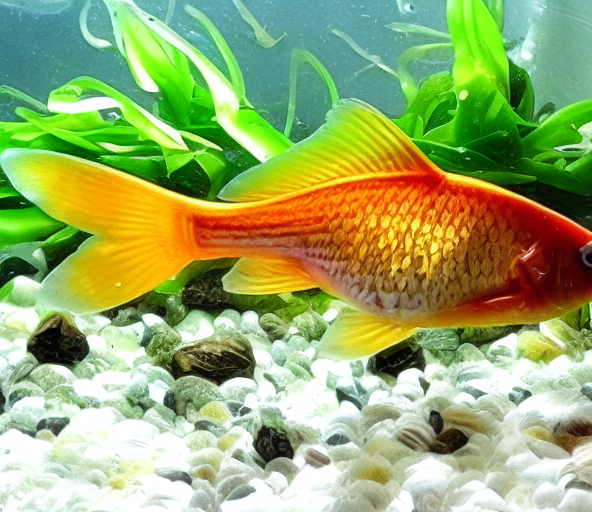

✓ Saved: fish_2_a_single_colorful_fish_swimmin.png


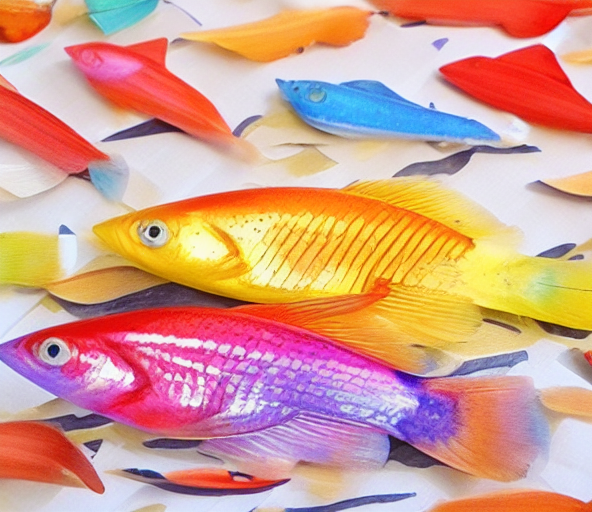

✓ Saved: fish_3_a_single_tropical_fish,_ultra_.png


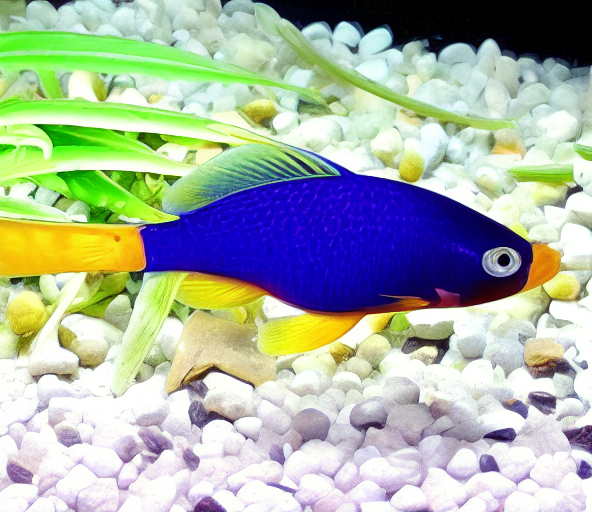

✓ Saved: fish_4_a_single_aquarium_fish,_ultra_.png


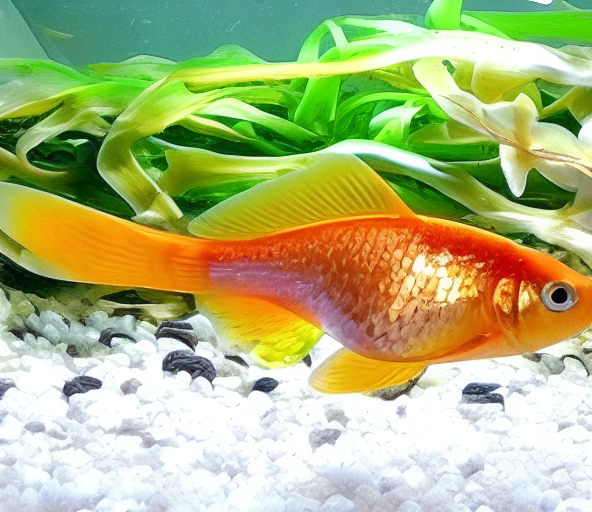

✓ Saved: fish_5_a_single_beautiful_fish_underw.png


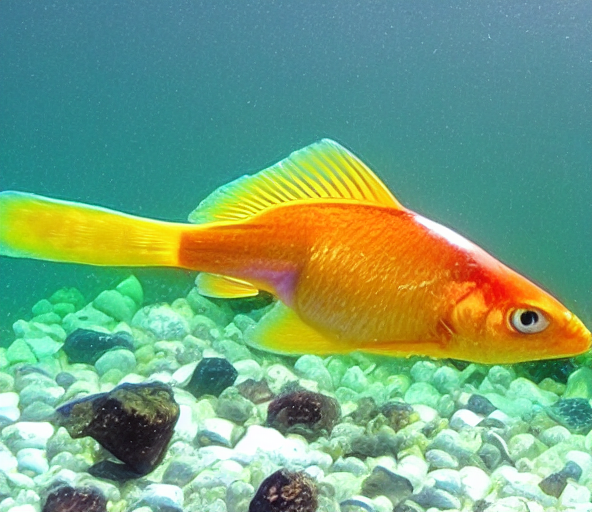


✓ All images saved to: /content/generated_fish


In [ ]:
# ============================================================================
# CELL 5: Generate Images - Basic
# ============================================================================
print("\n🎨 Generating fish images...")

# Generation parameters
prompts = [
    "a single fish in aquarium, ultra detailed scales and fins, sharp, high resolution",
    "a single colorful fish swimming, ultra detailed scales and fins, sharp, high resolution",
    "a single tropical fish, ultra detailed scales and fins, sharp, high resolution",
    "a single aquarium fish, ultra detailed scales and fins, sharp, high resolution",
    "a single beautiful fish underwater, ultra detailed scales and fins, sharp, high resolution",
]

# Optional: Reduce metallic look
negative_prompt = "multiple fish, motion blur, movement blur, blur trail, fast motion, speed lines, out of focus, dynamic blur, action blur, two fish, duplicate, extra eyes, deformed eyes, multiple eyes, distorted, mutated, blurry, smooth, plastic, metallic, net, web, white net, aquarium glass, glass wall, tank wall, blue glass, ribbed glass, textured glass, corrugated background, diagonal lines, striped background, patterned wall"

# Generate
images = pipeline(
    prompts,
    negative_prompt=[negative_prompt] * len(prompts),
    num_inference_steps=50,
    guidance_scale=6.5,  # Higher guidance
    num_images_per_prompt=1,
    width=592,     # wider aspect
    height=512,
).images

# Display and save
output_dir = "/content/generated_fish"
os.makedirs(output_dir, exist_ok=True)

print(f"\n✓ Generated {len(images)} images")
print(f"Saving to: {output_dir}\n")

for i, (img, prompt) in enumerate(zip(images, prompts)):
    # Save
    filename = f"fish_{i+1}_{prompt.replace(' ', '_')[:30]}.png"
    save_path = f"{output_dir}/{filename}"
    img.save(save_path)
    print(f"✓ Saved: {filename}")

    # Display
    display(img)

print(f"\n✓ All images saved to: {output_dir}")




🎨 Advanced generation with custom parameters...


  0%|          | 0/50 [00:00<?, ?it/s]


✓ Generated 4 images with custom settings
Prompt: a beautiful golden fish swimming in clear aquarium water, ultra detailed scales and fins, sharp, high resolution
Steps: 50, CFG: 6.5

✓ Saved: custom_fish_1.png


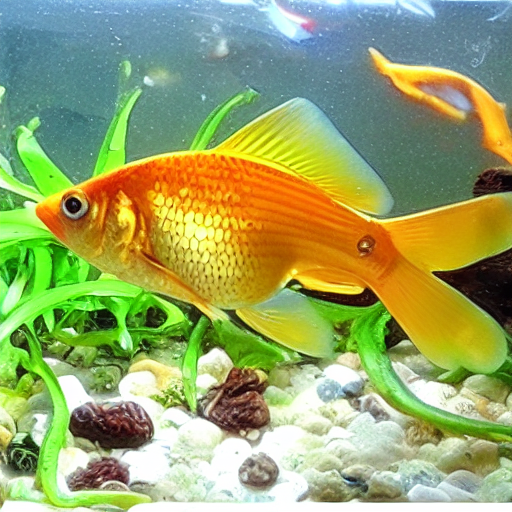

✓ Saved: custom_fish_2.png


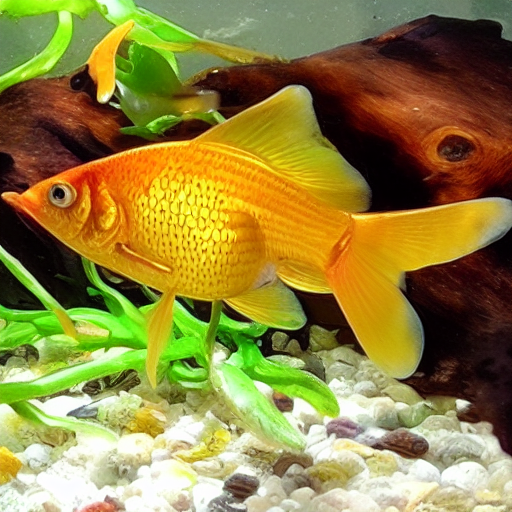

✓ Saved: custom_fish_3.png


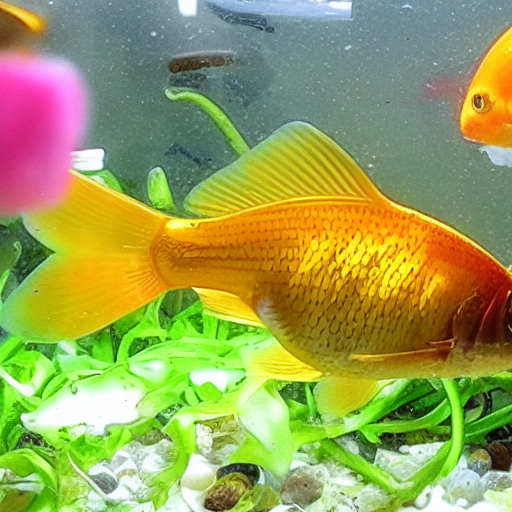

✓ Saved: custom_fish_4.png


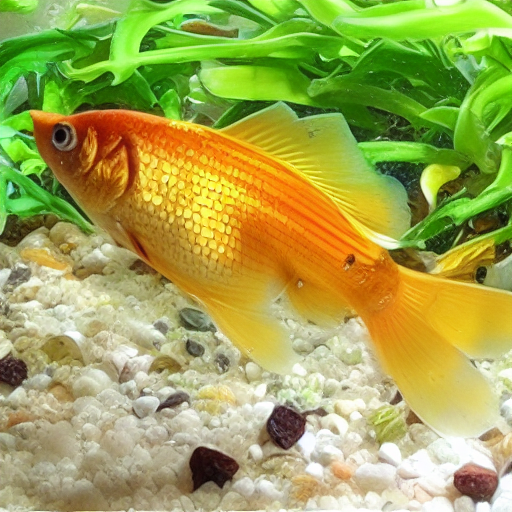

In [ ]:
# ============================================================================
# CELL 6: Generate Images - Advanced (Custom Parameters)
# ============================================================================
print("\n🎨 Advanced generation with custom parameters...")

# Custom generation settings
custom_config = {
    "prompt": "a beautiful golden fish swimming in clear aquarium water, ultra detailed scales and fins, sharp, high resolution",
    "negative_prompt": "multiple fish, two fish, duplicate, extra eyes, deformed eyes, multiple eyes, distorted, motion blur, movement blur, blur trail, fast motion, speed lines, out of focus, dynamic blur, action blur, mutated, blurry, smooth, plastic, metallic, net, web, white net, aquarium glass, glass wall, tank wall, blue glass, ribbed glass, textured glass, corrugated background, diagonal lines, striped background, patterned wall",
    "num_images": 4,
    "steps": 50,  # More steps = higher quality
    "guidance_scale": 6.5,
    "width": 592,     # wider aspect
    "height": 512,
}


generator = torch.Generator(device=device)

# Generate
custom_images = pipeline(
    [custom_config["prompt"]] * custom_config["num_images"],
    negative_prompt=[custom_config["negative_prompt"]] * custom_config["num_images"],
    num_inference_steps=custom_config["steps"],
    guidance_scale=custom_config["guidance_scale"],
    generator=generator,
).images

# Display
print(f"\n✓ Generated {len(custom_images)} images with custom settings")
print(f"Prompt: {custom_config['prompt']}")
print(f"Steps: {custom_config['steps']}, CFG: {custom_config['guidance_scale']}\n")

for i, img in enumerate(custom_images):
    filename = f"custom_fish_{i+1}.png"
    img.save(f"{output_dir}/{filename}")
    print(f"✓ Saved: {filename}")
    display(img)




🎨 Batch generation - creating multiple variations...

[1/6] Generating: a complete single gold molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, in clear water, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 647472)...
  ✓ Saved variation 1
  Variation 2 (seed: 769347)...
  ✓ Saved variation 2
  Variation 3 (seed: 272316)...
  ✓ Saved variation 3

[2/6] Generating: a complete single guppy fish with head, body and tail visible, full fish from head to tail, highly detailed, colorful tale, in clear water, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 821241)...
  ✓ Saved variation 1
  Variation 2 (seed: 519401)...
  ✓ Saved variation 2
  Variation 3 (seed: 644009)...
  ✓ Saved variation 3

[3/6] Generating: a complete single goldfish with head, body and tail visible, full fish from head to tail, highly detailed, in clear water, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 463962)...
  ✓ Saved variation 1
  Variation 2 (seed: 59305)...
  ✓ Saved variation 2
  Variation 3 (seed: 940207)...
  ✓ Saved variation 3

[4/6] Generating: a complete single ancistrus catfish with head, body and tail visible, full fish from head to tail, highly detailed, on substrate, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 108933)...
  ✓ Saved variation 1
  Variation 2 (seed: 767644)...
  ✓ Saved variation 2
  Variation 3 (seed: 855034)...
  ✓ Saved variation 3

[5/6] Generating: a complete single black molly fish with head, body and tail visible, full fish from head to tail, highly detailed, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 753091)...
  ✓ Saved variation 1
  Variation 2 (seed: 474202)...
  ✓ Saved variation 2
  Variation 3 (seed: 451078)...
  ✓ Saved variation 3

[6/6] Generating: a complete single dalmatian molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, sharp focus


  0%|          | 0/50 [00:00<?, ?it/s]

  Variation 1 (seed: 352492)...
  ✓ Saved variation 1
  Variation 2 (seed: 578310)...
  ✓ Saved variation 2
  Variation 3 (seed: 527776)...
  ✓ Saved variation 3

✓ Batch generation complete!
Total images: 18
Saved to: /content/generated_fish/batch_20251008_061039

All generated images (grouped by prompt):

a complete single gold molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, in clear water, sharp focus:


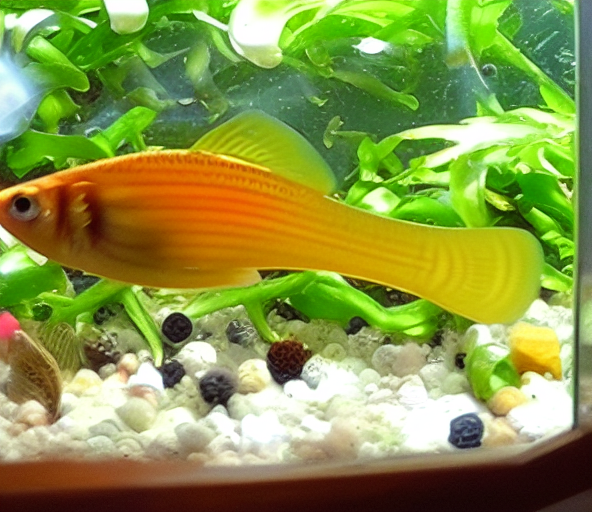

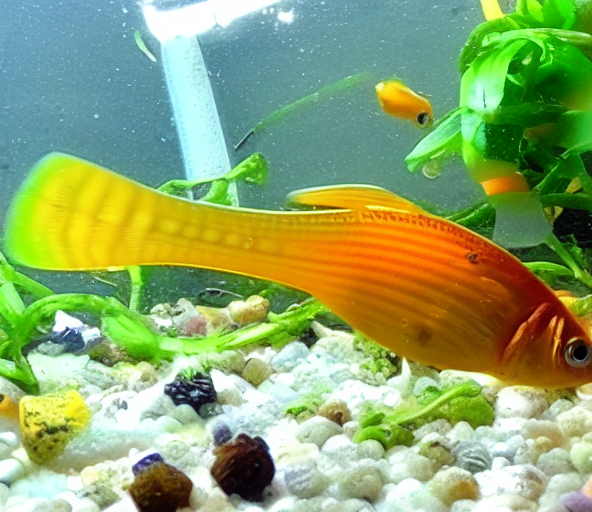

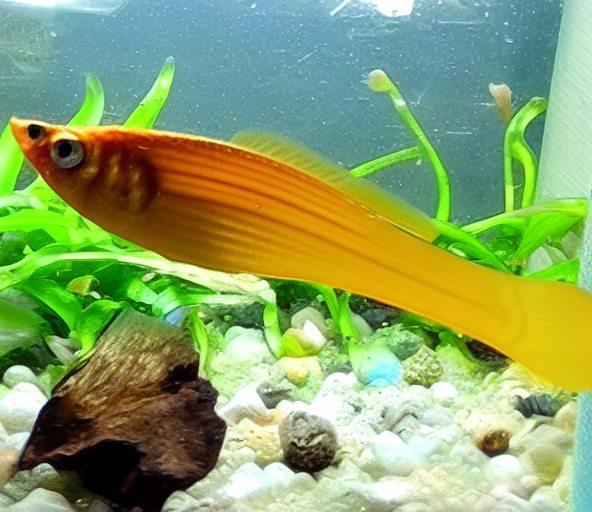


a complete single guppy fish with head, body and tail visible, full fish from head to tail, highly detailed, colorful tale, in clear water, sharp focus:


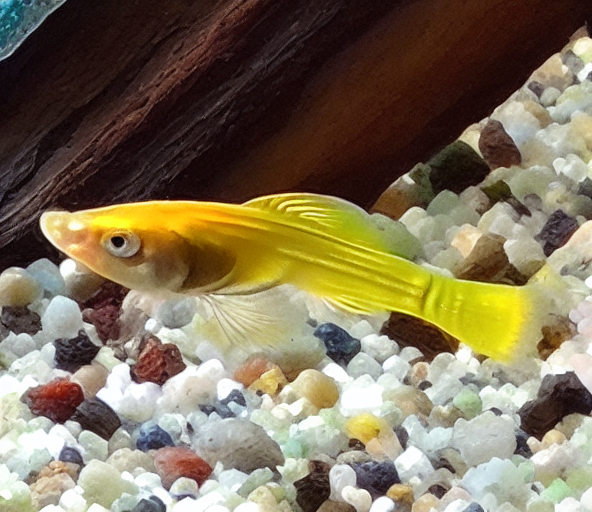

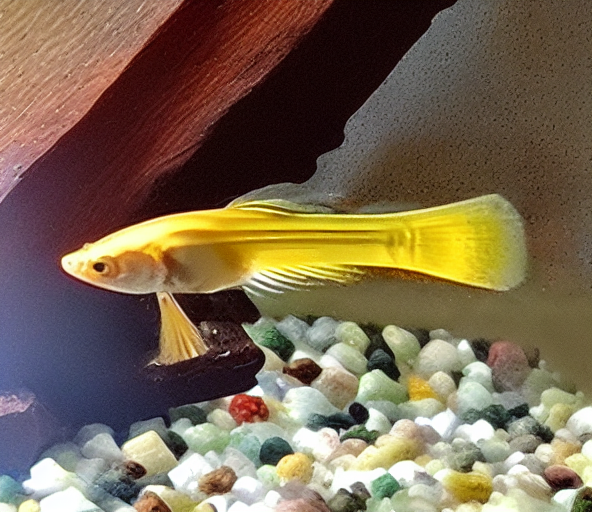

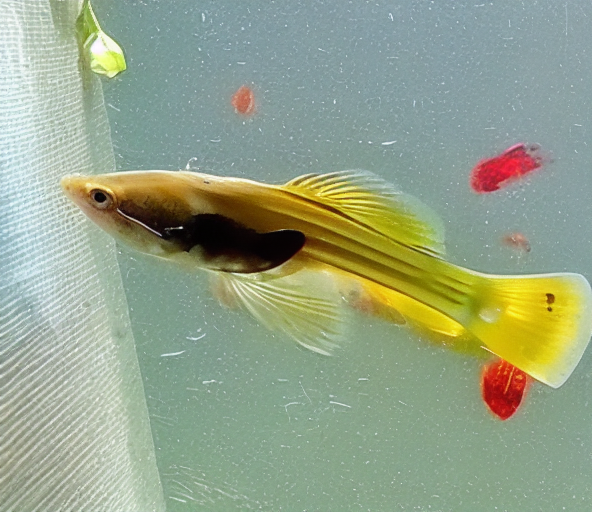


a complete single goldfish with head, body and tail visible, full fish from head to tail, highly detailed, in clear water, sharp focus:


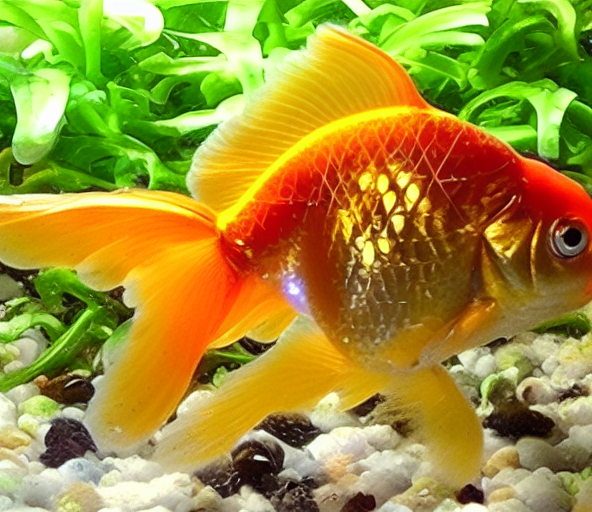

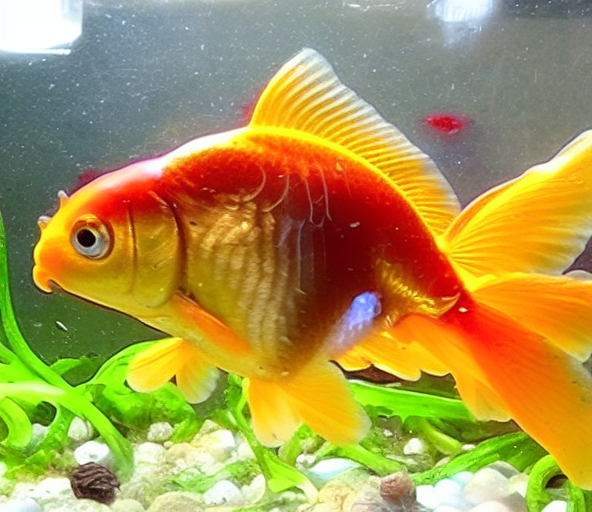

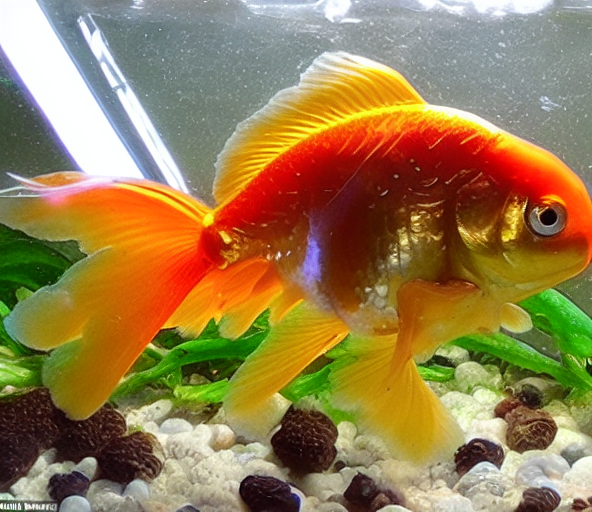


a complete single ancistrus catfish with head, body and tail visible, full fish from head to tail, highly detailed, on substrate, sharp focus:


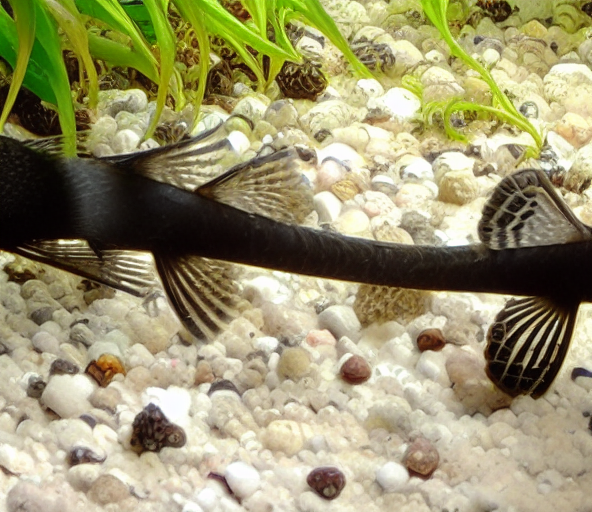

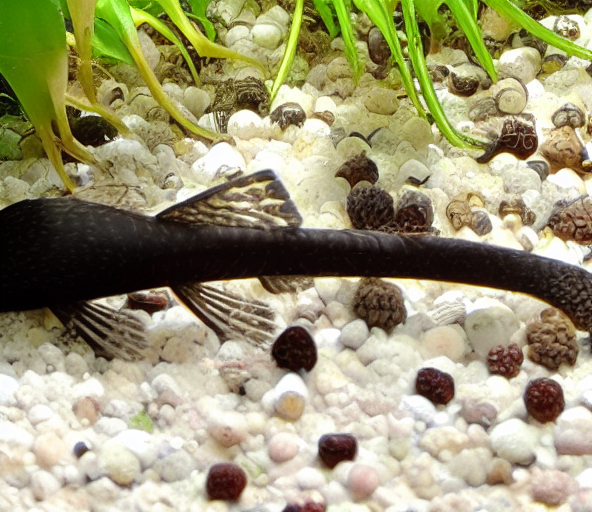

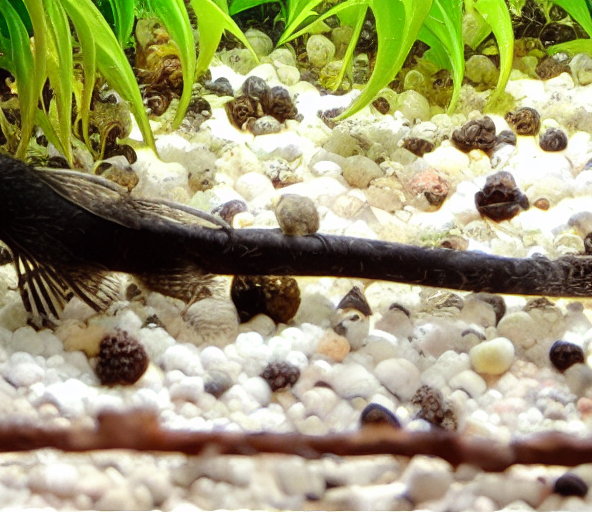


a complete single black molly fish with head, body and tail visible, full fish from head to tail, highly detailed, sharp focus:


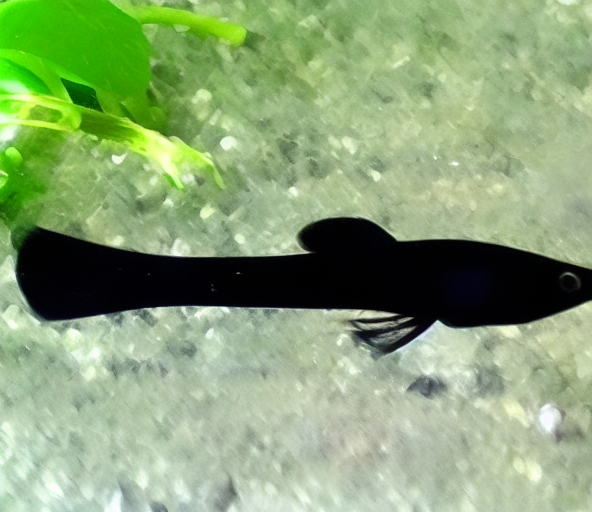

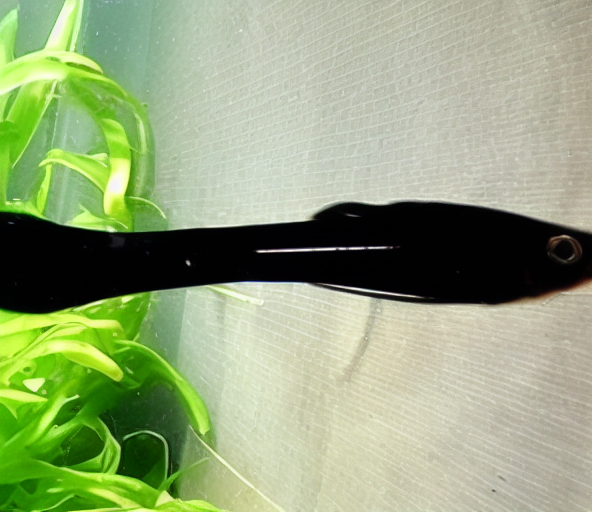

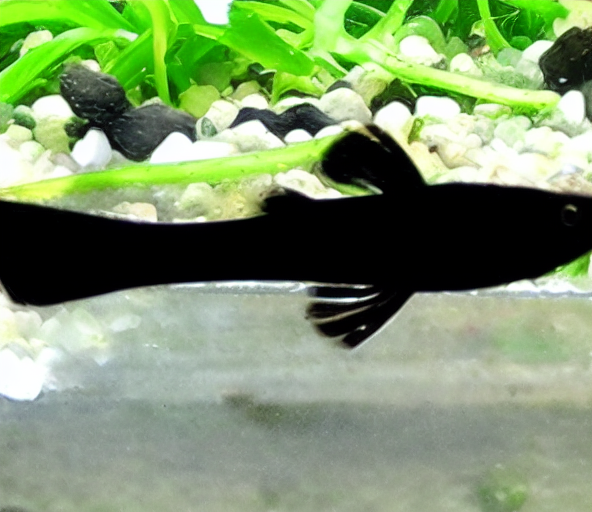


a complete single dalmatian molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, sharp focus:


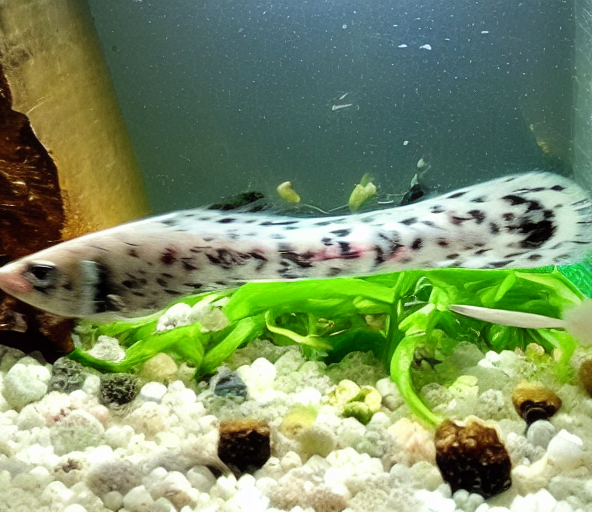

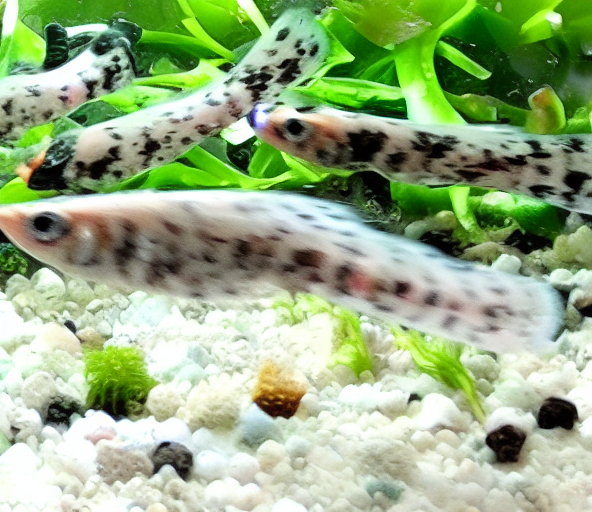

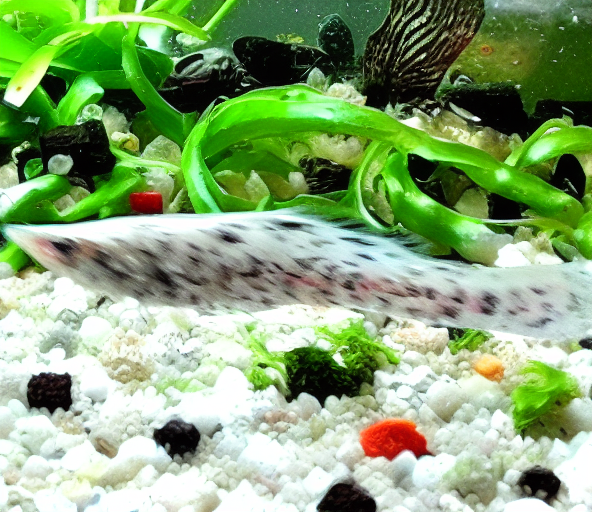

In [ ]:
# ============================================================================
# CELL 7: Batch Generation (Many Images)
# ============================================================================
import random

print("\n🎨 Batch generation - creating multiple variations...")

# Batch settings
batch_prompts = [
    "a complete single gold molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, in clear water, sharp focus",
    "a complete single guppy fish with head, body and tail visible, full fish from head to tail, highly detailed, colorful tale, in clear water, sharp focus",
    "a complete single goldfish with head, body and tail visible, full fish from head to tail, highly detailed, in clear water, sharp focus",
    "a complete single ancistrus catfish with head, body and tail visible, full fish from head to tail, highly detailed, on substrate, sharp focus",
    "a complete single black molly fish with head, body and tail visible, full fish from head to tail, highly detailed, sharp focus",
    "a complete single dalmatian molly fish with head, body and tail visible, full fish from head to tail, highly detailed, swimming in aquarium, sharp focus",
]

num_variations = 3  # Generate 3 variations of each prompt

all_images = []
batch_output_dir = f"{output_dir}/batch_{datetime.now().strftime('%Y%m%d_%H%M%S')}"
os.makedirs(batch_output_dir, exist_ok=True)

for prompt_idx, prompt in enumerate(batch_prompts):
    print(f"\n[{prompt_idx+1}/{len(batch_prompts)}] Generating: {prompt}")

    # Generate variations
    variations = pipeline(
        [prompt] * num_variations,
        negative_prompt=[
          #"artifacts, stripes, bands, patterns, noise, smudges, gradients, stains, background artifacts, "
          "multiple fish, duplicate, extra eyes, multiple eyes, double eyes, four eyes, "
          "deformed eyes, extra fins, multiple fins, duplicate fins, mutated, distorted, "
          "disfigured, malformed, duplicate body parts, motion blur, blurry, smooth, "
          "headless, no head, missing head, cropped head, decapitated, partial fish, cut off "
          "cropped, partial, cut off, incomplete, half fish, head only, tail only, body cut, edge of frame"
          "plastic, metallic, aquarium glass, ribbed glass"] * num_variations,
        num_inference_steps=50,
        guidance_scale=6.5,
        width=592,     # wider aspect
        height=512,
      ).images

    # Save each variation
    for var_idx, img in enumerate(variations):
        # Generate unique seed for each image
        seed = random.randint(0, 999999)
        generator = torch.Generator(device=device).manual_seed(seed)

        print(f"  Variation {var_idx+1} (seed: {seed})...")

        filename = f"prompt{prompt_idx+1}_var{var_idx+1}_seed{seed}_{prompt.replace(' ', '_')[:20]}.png"

        save_path = f"{batch_output_dir}/{filename}"
        img.save(save_path)
        all_images.append((prompt, img))
        print(f"  ✓ Saved variation {var_idx+1}")

print(f"\n✓ Batch generation complete!")
print(f"Total images: {len(all_images)}")
print(f"Saved to: {batch_output_dir}")


# Display all images grouped by prompt
print("\nAll generated images (grouped by prompt):")
for prompt_idx in range(len(batch_prompts)):
    start_idx = prompt_idx * num_variations
    end_idx = start_idx + num_variations

    print(f"\n{batch_prompts[prompt_idx]}:")
    for i in range(start_idx, end_idx):
        display(all_images[i][1])  # [1] gets the image from tuple



In [ ]:
# ============================================================================
# CELL 8: Download Generated Images (Current Batch Only)
# ============================================================================
from google.colab import files
import zipfile

print("\n📦 Creating ZIP archive of generated images...")

zip_filename = f"generated_fish_{datetime.now().strftime('%Y%m%d_%H%M%S')}.zip"
zip_path = f"/content/{zip_filename}"

with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
    # Add images ONLY from current batch directory
    if os.path.exists(batch_output_dir):  # ✅ Use batch_output_dir from CELL 7
        for filename in os.listdir(batch_output_dir):
            if filename.endswith('.png'):
                file_path = os.path.join(batch_output_dir, filename)
                zipf.write(file_path, filename)  # Add with just filename (no subdirs)

        print(f"✓ Zipped {len(os.listdir(batch_output_dir))} images from current batch")
    else:
        print(f"⚠️ Batch directory not found: {batch_output_dir}")

zip_size = os.path.getsize(zip_path) / (1024**2)
print(f"✓ Archive created: {zip_filename} ({zip_size:.2f} MB)")
print(f"   From: {batch_output_dir}")
print(f"\n⬇️ Downloading to your computer...")

files.download(zip_path)
print("✓ Download started! Check your browser's download folder.")


📦 Creating ZIP archive of generated images...
✓ Zipped 18 images from current batch
✓ Archive created: generated_fish_20251008_060400.zip (8.97 MB)
   From: /content/generated_fish/batch_20251008_060049

⬇️ Downloading to your computer...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

✓ Download started! Check your browser's download folder.


In [ ]:
# ============================================================================
# CELL 9: Clean Up (Optional)
# ============================================================================
# Uncomment to free up memory and disk space

# import shutil
#
# # Free GPU memory
# del pipeline
# torch.cuda.empty_cache()
#
# # Remove downloaded model (optional)
# # shutil.rmtree(LOCAL_LORA_PATH)
#
# print("✓ Cleanup complete")